In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8 MB 23 kB/s 
     |████████████████████████████████| 6.6 MB 31.9 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.11.0+cu113
    Uninstalling torch-1.11.0+cu113:
      Successfully uninstalled torch-1.11.0+cu113
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.12.0+cu113
    Uninstalling torchvision-0.12.0+cu113:
      Successfully uninstalled torchvision-0.12.0+cu113
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.12.0 requires torch==1.11.0, but you have torch 1.5.0+cu101 which is incompatible.
torchaudio 0.11.0+cu113 requires torch==1.11.0, but you have torch 1.5.0+cu101 which is incompatible.
     |████████████████████████████████| 274 kB 4.3 MB/s 
  Created wheel fo

In [2]:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html
     |████████████████████████████████| 6.2 MB 704 kB/s 
     |████████████████████████████████| 50 kB 2.2 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220506-py3-none-any.whl size=61284 sha256=6d76e3c59b20aee973ae250070007964218a20fdba29dc7b1689df912507dd1a
  Stored in directory: /root/.cache/pip/wheels/f5/ef/3c/708de8799f89f0871bd209866831fe3885db93fa090608fa73
Successfully built fvcore


In [18]:
!mkdir /content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion
!gdown  https://drive.google.com/drive/u/0/folders/125F48fsMBz2EF0Cpqk6aaHet5VH399Ok -O /content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/validation.zip

mkdir: cannot create directory ‘/content/drive/MyDrive/Computer’: File exists
mkdir: cannot create directory ‘Projects/Object’: No such file or directory
mkdir: cannot create directory ‘Detection/DeepFashion’: No such file or directory
usage: gdown [-h] [-V] [-O OUTPUT] [-q] [--fuzzy] [--id] [--proxy PROXY]
             [--speed SPEED] [--no-cookies] [--no-check-certificate]
             [--continue] [--folder] [--remaining-ok]
             url_or_id
gdown: error: unrecognized arguments: Vision Projects/Object Detection/DeepFashion/DeepFashion2/validation.zip


In [3]:
%cd /content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2

/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2


In [4]:
!ls

deepfashion2_validation.json  images.jpg  validation
example.jfif		      output	  validation.zip


In [23]:
!unzip -P "2019Deepfashion2**" validation.zip 

Streaming output truncated to the last 5000 lines.
  inflating: validation/image/007349.jpg  
  inflating: validation/image/007310.jpg  
  inflating: validation/image/007286.jpg  
  inflating: validation/image/007274.jpg  
  inflating: validation/image/007218.jpg  
  inflating: validation/image/007216.jpg  
  inflating: validation/image/007204.jpg  
  inflating: validation/image/007133.jpg  
  inflating: validation/image/007081.jpg  
  inflating: validation/image/007045.jpg  
  inflating: validation/image/007044.jpg  
  inflating: validation/image/007017.jpg  
  inflating: validation/image/006960.jpg  
  inflating: validation/image/006868.jpg  
  inflating: validation/image/006831.jpg  
  inflating: validation/image/006773.jpg  
  inflating: validation/image/006744.jpg  
  inflating: validation/image/006720.jpg  
  inflating: validation/image/006711.jpg  
  inflating: validation/image/006696.jpg  
  inflating: validation/image/006591.jpg  
  inflating: validation/image/006587.jpg  
  i

In [24]:
!ls validation/image | wc -l
!ls validation/annos | wc -l

32153
32153


In [25]:
!ls

deepfashion2_validation.json  images.jpg  validation
example.jfif		      output	  validation.zip


In [26]:
from PIL import Image
import numpy as np
import json

dataset = {
    "info": {},
    "licenses": [],
    "images": [],
    "annotations": [],
    "categories": []
}

lst_name = ['short_sleeved_shirt', 'long_sleeved_shirt', 'short_sleeved_outwear', 'long_sleeved_outwear',
            'vest', 'sling', 'shorts', 'trousers', 'skirt', 'short_sleeved_dress',
            'long_sleeved_dress', 'vest_dress', 'sling_dress']

for idx, e  in enumerate(lst_name):
    dataset['categories'].append({
        'id': idx + 1,
        'name': e,
        'supercategory': "clothes",
        'keypoints': ['%i' % (i) for i in range(1, 295)],
        'skeleton': []
    })

num_images = 32153 #191961 
sub_index = 0  # the index of ground truth instance
for num in range(1, num_images + 1):
    json_name = '/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/validation/annos/' + str(num).zfill(6) + '.json'
    image_name = '/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/validation/image/' + str(num).zfill(6) + '.jpg'

    if (num >= 0):
        imag = Image.open(image_name)
        width, height = imag.size
        with open(json_name, 'r') as f:
            temp = json.loads(f.read())
            pair_id = temp['pair_id']

            dataset['images'].append({
                'coco_url': '',
                'date_captured': '',
                'file_name': str(num).zfill(6) + '.jpg',
                'flickr_url': '',
                'id': num,
                'license': 0,
                'width': width,
                'height': height
            })
            for i in temp:
                if i == 'source' or i == 'pair_id':
                    continue
                else:
                    points = np.zeros(294 * 3)
                    sub_index = sub_index + 1
                    box = temp[i]['bounding_box']
                    w = box[2] - box[0]
                    h = box[3] - box[1]
                    x_1 = box[0]
                    y_1 = box[1]
                    bbox = [x_1, y_1, w, h]
                    cat = temp[i]['category_id']
                    style = temp[i]['style']
                    seg = temp[i]['segmentation']
                    landmarks = temp[i]['landmarks']

                    points_x = landmarks[0::3]
                    points_y = landmarks[1::3]
                    points_v = landmarks[2::3]
                    points_x = np.array(points_x)
                    points_y = np.array(points_y)
                    points_v = np.array(points_v)
                    case = [0, 25, 58, 89, 128, 143, 158, 168, 182, 190, 219, 256, 275, 294]
                    idx_i, idx_j = case[cat - 1], case[cat]

                    for n in range(idx_i, idx_j):
                        points[3 * n] = points_x[n - idx_i]
                        points[3 * n + 1] = points_y[n - idx_i]
                        points[3 * n + 2] = points_v[n - idx_i]

                    num_points = len(np.where(points_v > 0)[0])

                    dataset['annotations'].append({
                        'area': w * h,
                        'bbox': bbox,
                        'category_id': cat,
                        'id': sub_index,
                        'pair_id': pair_id,
                        'image_id': num,
                        'iscrowd': 0,
                        'style': style,
                        'num_keypoints': num_points,
                        'keypoints': points.tolist(),
                        'segmentation': seg,
                    })

json_name = '/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/deepfashion2_validation.json'
with open(json_name, 'w') as f:
    json.dump(dataset, f)

In [27]:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import os
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

In [28]:
from detectron2.data.datasets import register_coco_instances
#register_coco_instances("deepfashion_train", {}, "/content/DeepFashion2/deepfashion2_train.json", "/content/DeepFashion2/train/image")
register_coco_instances("deepfashion_val2", {}, "/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/deepfashion2_validation.json", "/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/validation/image")

In [29]:
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("deepfashion_val2",)
cfg.DATASETS.TEST = ()
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")  # Let training initialize from model zoo

cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 3000
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13

cfg.TEST.EVAL_PERIOD = 500

In [30]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[05/09 06:40:51 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (14, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (14,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (52, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (52,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias

[05/09 06:41:21 d2.engine.train_loop]: Starting training from iteration 0
[05/09 06:41:37 d2.utils.events]:  eta: 0:36:59  iter: 19  total_loss: 3.401  loss_cls: 2.453  loss_box_reg: 0.885  loss_rpn_cls: 0.035  loss_rpn_loc: 0.015  time: 0.7525  data_time: 0.0713  lr: 0.000020  max_mem: 6561M
[05/09 06:41:52 d2.utils.events]:  eta: 0:36:55  iter: 39  total_loss: 2.984  loss_cls: 2.091  loss_box_reg: 0.889  loss_rpn_cls: 0.019  loss_rpn_loc: 0.014  time: 0.7597  data_time: 0.0221  lr: 0.000040  max_mem: 6865M
[05/09 06:42:07 d2.utils.events]:  eta: 0:36:40  iter: 59  total_loss: 2.175  loss_cls: 1.297  loss_box_reg: 0.881  loss_rpn_cls: 0.020  loss_rpn_loc: 0.020  time: 0.7597  data_time: 0.0234  lr: 0.000060  max_mem: 6865M
[05/09 06:42:22 d2.utils.events]:  eta: 0:36:34  iter: 79  total_loss: 1.903  loss_cls: 0.985  loss_box_reg: 0.867  loss_rpn_cls: 0.027  loss_rpn_loc: 0.022  time: 0.7592  data_time: 0.0215  lr: 0.000080  max_mem: 6865M
[05/09 06:42:38 d2.utils.events]:  eta: 0:36:1

In [31]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [32]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.55   # set the testing threshold for this model
cfg.DATASETS.TEST = ("deepfashion_val2", )
predictor = DefaultPredictor(cfg)

In [33]:
!wget https://img-lcwaikiki.mncdn.com/mnresize/1024/-//productimages/20201/1/3945185/l_20201-0sg016z8-cs8_a.jpg -O /content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/images.jpg

/content/drive/MyDrive/Computer: Is a directory


In [34]:
from detectron2.utils.visualizer import ColorMode
im = cv2.imread("/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/images.jpg")
outputs = predictor(im)

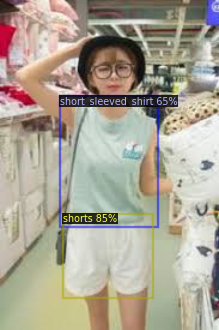

In [35]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

In [36]:
import uuid 

boxes = {}
for coordinates in outputs["instances"].to("cpu").pred_boxes:
  coordinates_array = []
  for k in coordinates:
    coordinates_array.append(int(k))
  
  boxes[uuid.uuid4().hex[:].upper()] = coordinates_array

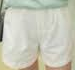

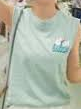

In [37]:
for k,v in boxes.items():
  crop_img = im[v[1]:v[3], v[0]:v[2], :]
  cv2_imshow(crop_img)
  cv2.imwrite(k + '.jpg', crop_img)


In [38]:
from detectron2.data import MetadataCatalog, DatasetCatalog


In [39]:
sample_metadata = MetadataCatalog.get("deepfashion_val2")
dataset_dicts = DatasetCatalog.get("deepfashion_val2")

[05/09 07:35:04 d2.data.datasets.coco]: Loading /content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/deepfashion2_validation.json takes 17.32 seconds.
[05/09 07:35:04 d2.data.datasets.coco]: Loaded 32153 images in COCO format from /content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/deepfashion2_validation.json


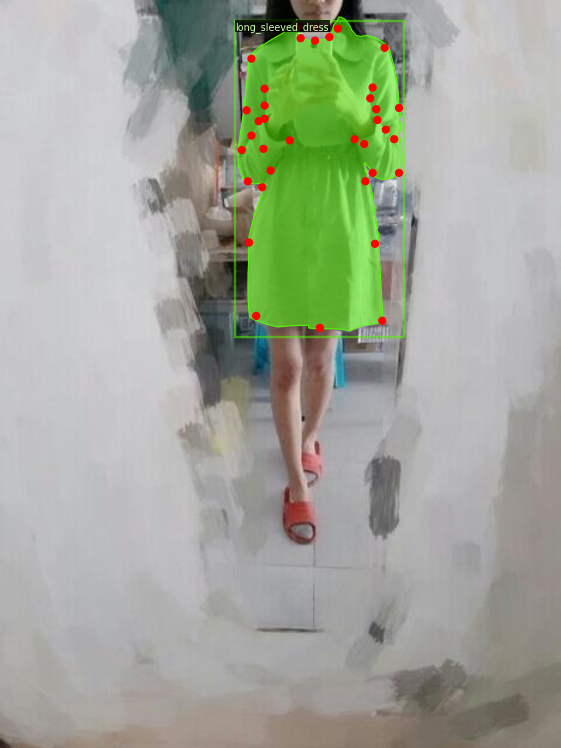

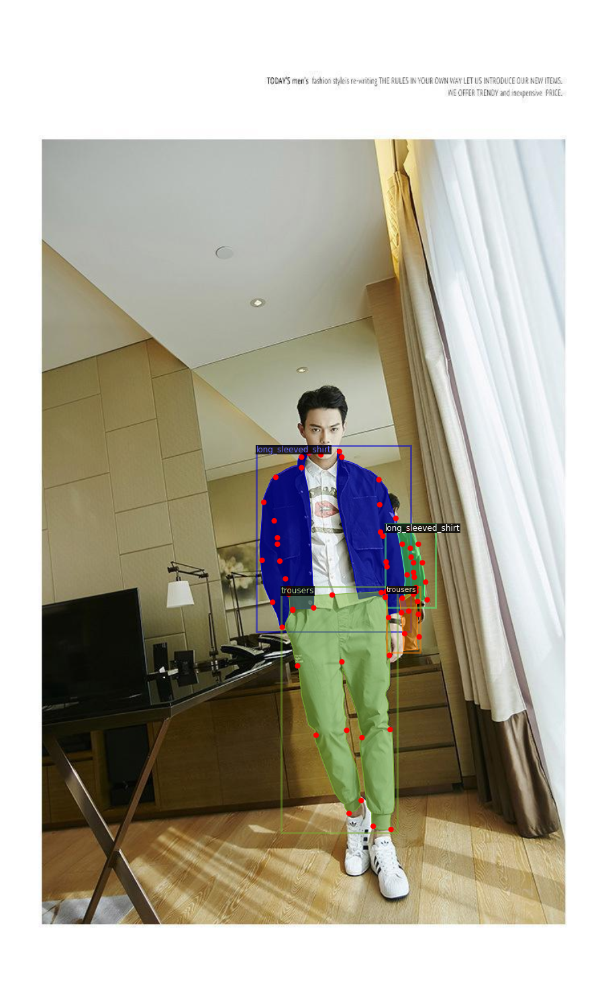

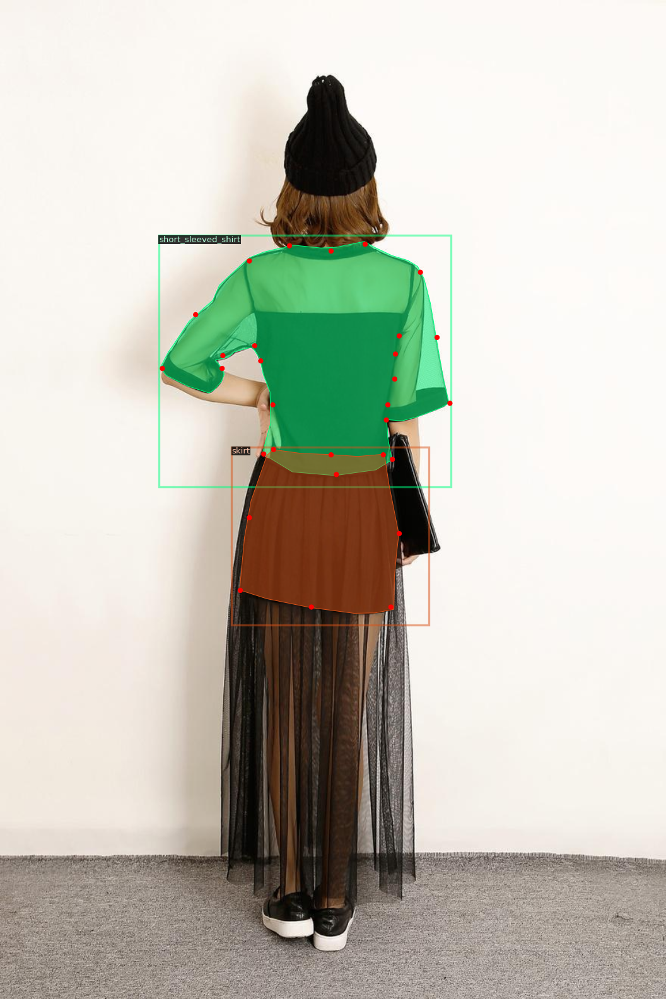

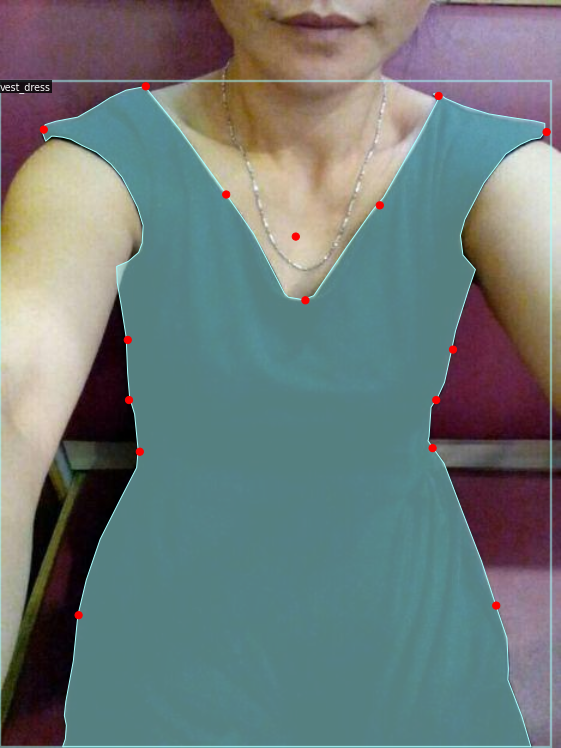

In [40]:
import random

for d in random.sample(dataset_dicts, 4):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=sample_metadata, scale=1.2)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

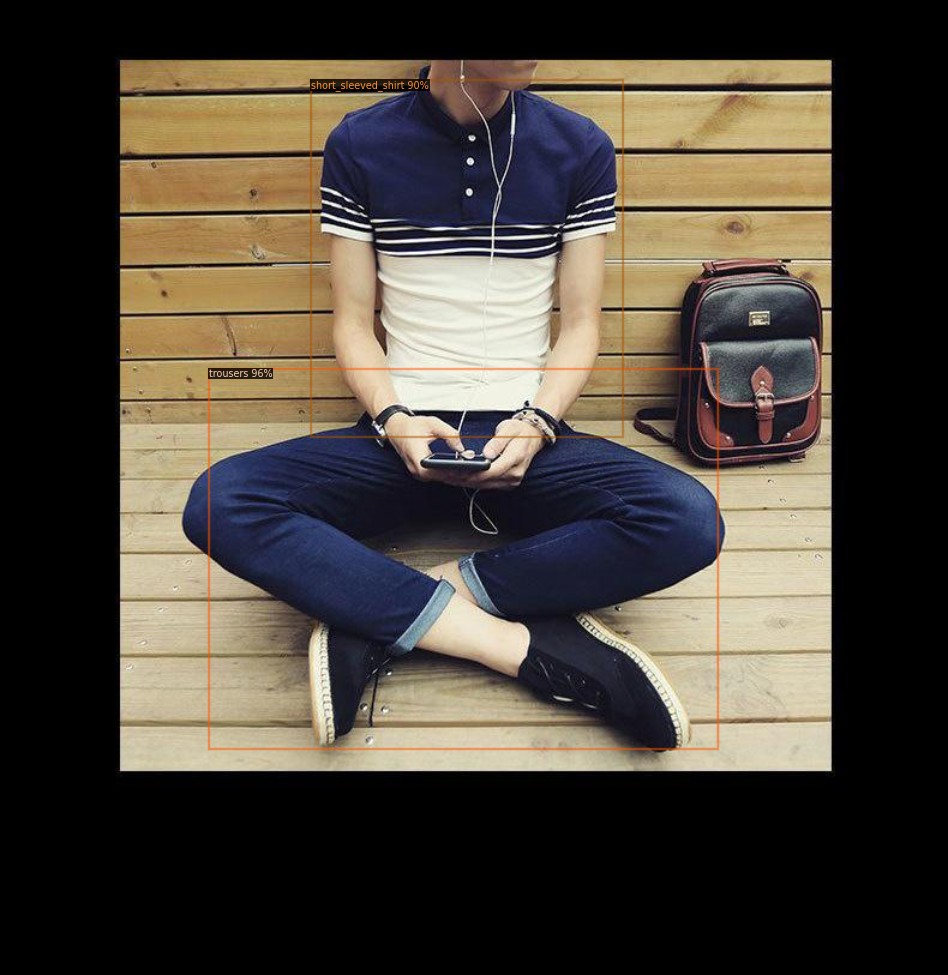

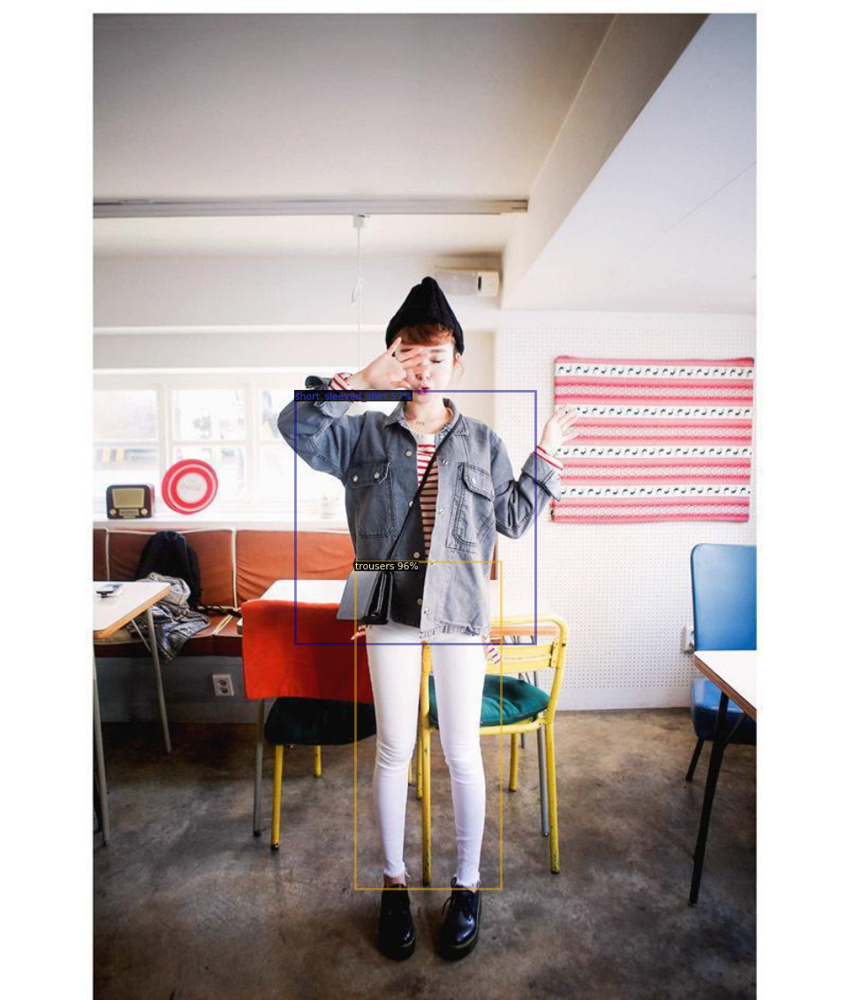

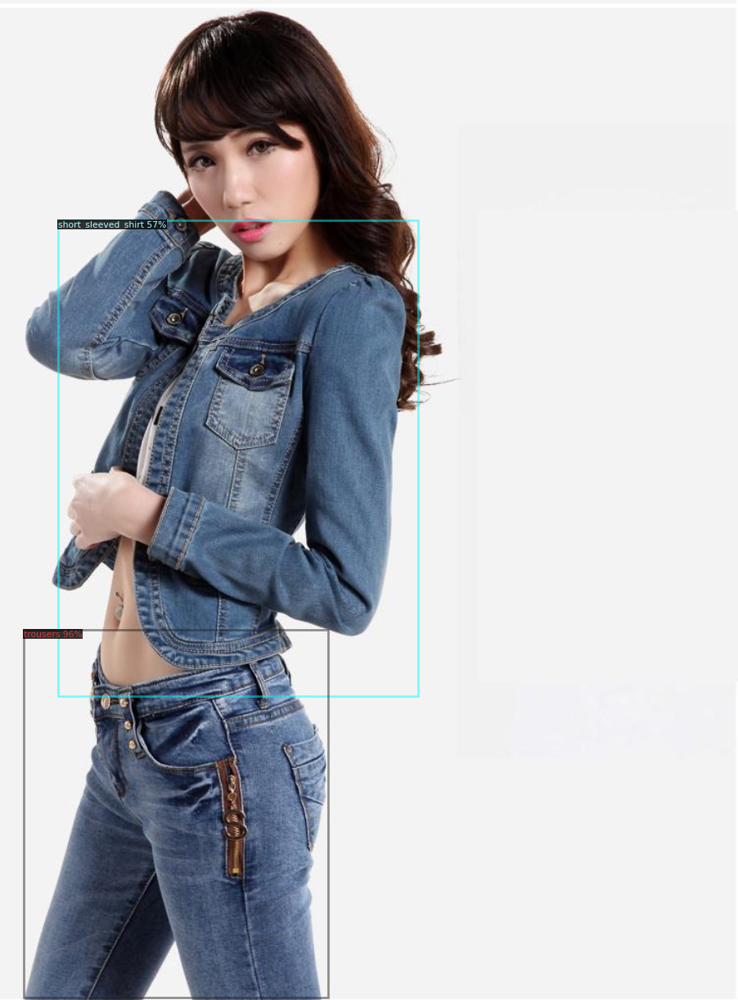

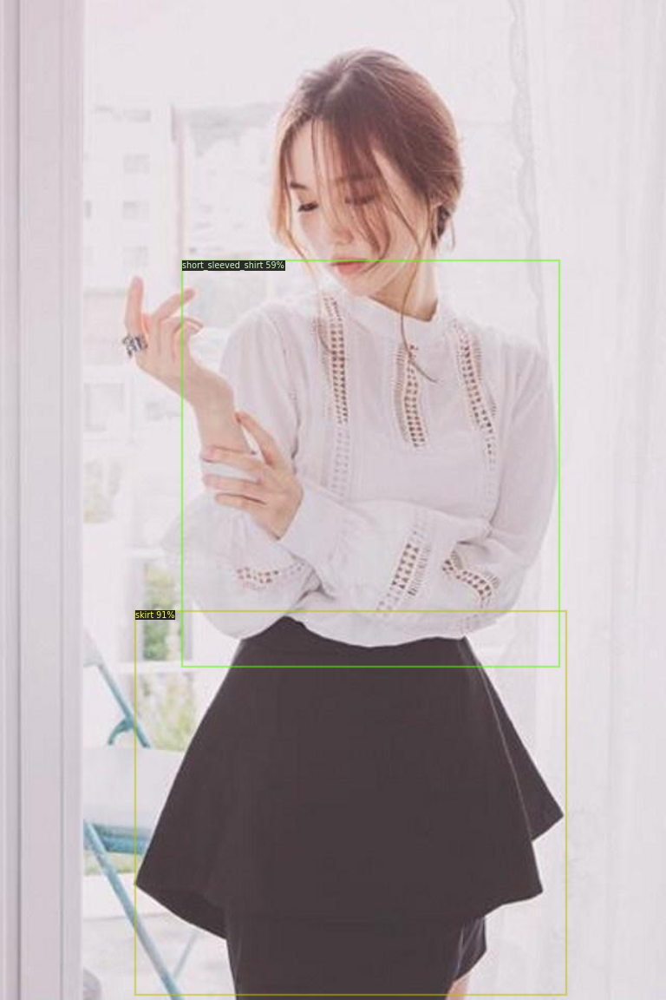

In [57]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 4):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])


In [58]:
f = open('config.yml', 'w')
f.write(cfg.dump())
f.close()

In [68]:
from detectron2.data.datasets import register_coco_instances
#register_coco_instances("deepfashion_train", {}, "/content/DeepFashion2/deepfashion2_train.json", "/content/DeepFashion2/train/image")
register_coco_instances("deepfashion_val3", {}, "/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/deepfashion2_validation.json", "/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/validation/image")

In [69]:
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("deepfashion_val3",)
cfg.DATASETS.TEST = ()
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo

cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13

cfg.TEST.EVAL_PERIOD = 500

In [70]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[05/09 08:08:32 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (14, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (14,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (52, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (52,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (13, 256, 1, 

[05/09 08:09:06 d2.engine.train_loop]: Starting training from iteration 0
[05/09 08:09:42 d2.utils.events]:  eta: 0:57:09  iter: 19  total_loss: 4.314  loss_cls: 2.688  loss_box_reg: 0.889  loss_mask: 0.693  loss_rpn_cls: 0.035  loss_rpn_loc: 0.021  time: 1.7339  data_time: 0.0951  lr: 0.000020  max_mem: 12118M
[05/09 08:10:16 d2.utils.events]:  eta: 0:55:45  iter: 39  total_loss: 3.884  loss_cls: 2.275  loss_box_reg: 0.954  loss_mask: 0.690  loss_rpn_cls: 0.025  loss_rpn_loc: 0.018  time: 1.7217  data_time: 0.0215  lr: 0.000040  max_mem: 12118M
[05/09 08:10:52 d2.utils.events]:  eta: 0:56:24  iter: 59  total_loss: 3.132  loss_cls: 1.420  loss_box_reg: 0.922  loss_mask: 0.683  loss_rpn_cls: 0.025  loss_rpn_loc: 0.020  time: 1.7393  data_time: 0.0218  lr: 0.000060  max_mem: 12118M
[05/09 08:11:26 d2.utils.events]:  eta: 0:55:49  iter: 79  total_loss: 2.643  loss_cls: 0.973  loss_box_reg: 0.912  loss_mask: 0.677  loss_rpn_cls: 0.033  loss_rpn_loc: 0.016  time: 1.7381  data_time: 0.0285  

In [72]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.55   # set the testing threshold for this model
cfg.DATASETS.TEST = ("deepfashion_val3", )
predictor = DefaultPredictor(cfg)

In [73]:
!wget https://img-lcwaikiki.mncdn.com/mnresize/1024/-//productimages/20201/1/3945185/l_20201-0sg016z8-cs8_a.jpg -O /content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/images.jpg

/content/drive/MyDrive/Computer: Is a directory


In [74]:
from detectron2.utils.visualizer import ColorMode
im = cv2.imread("/content/drive/MyDrive/Computer Vision Projects/Object Detection/DeepFashion/DeepFashion2/images.jpg")
outputs = predictor(im)

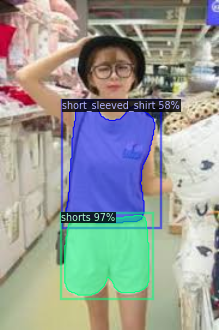

In [76]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

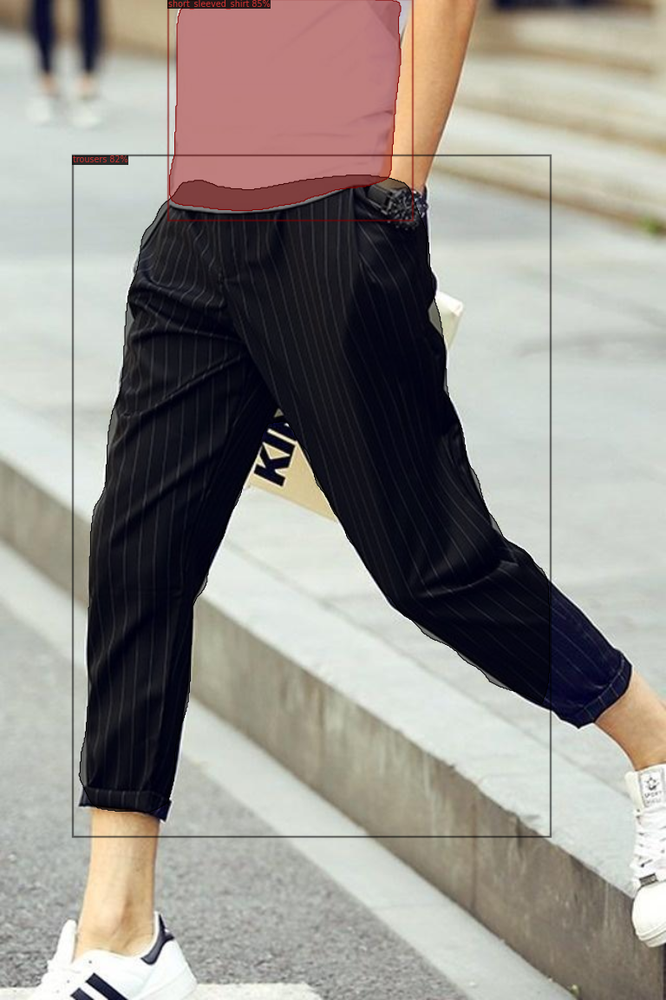

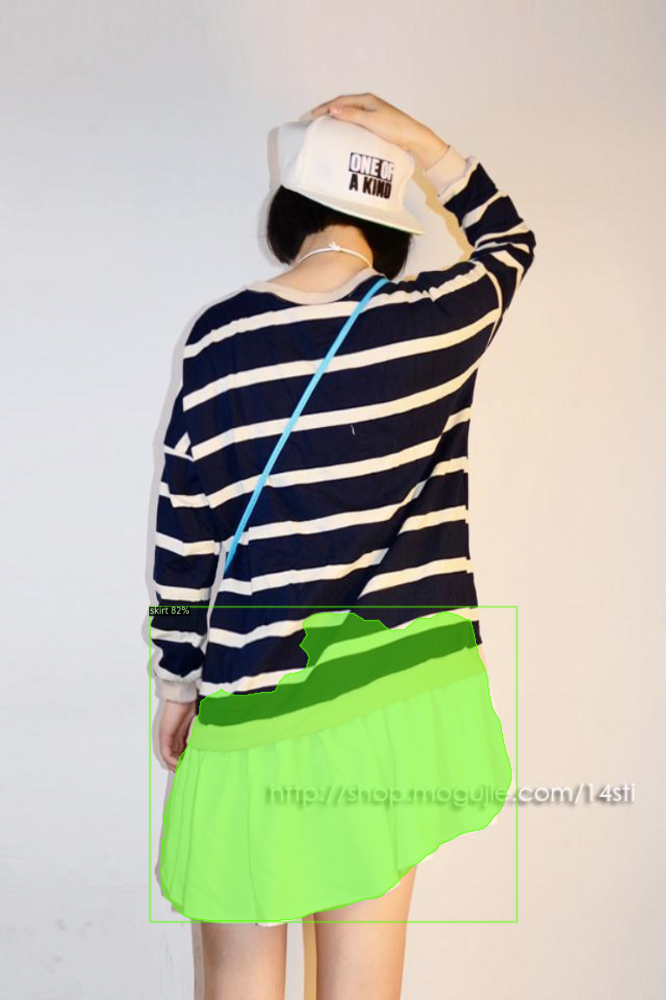

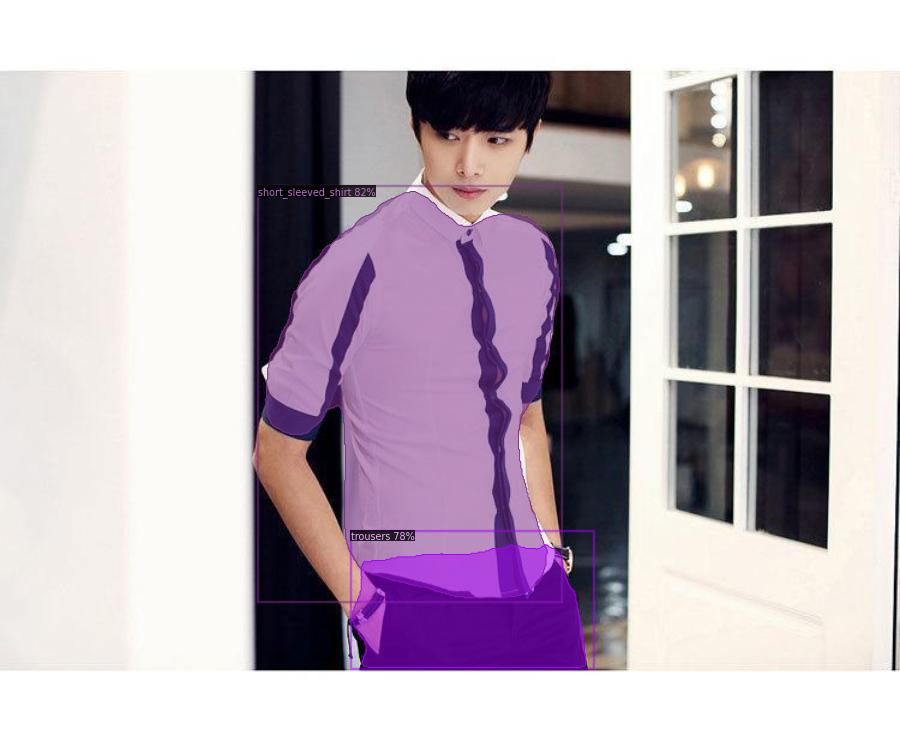

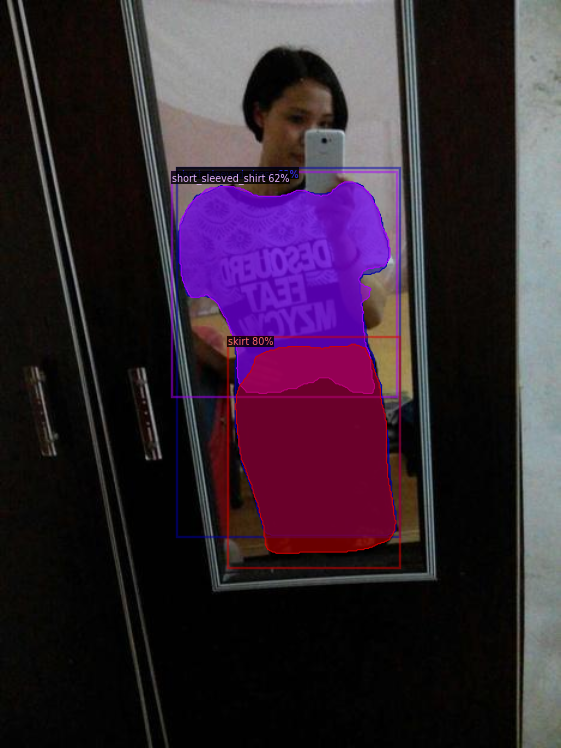

In [80]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 4):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])